In [1]:
# Set the appropriate home env
import os
os.environ['R_HOME'] = '/Users/amcfa/gitfiles/Projects/R-4.3.2/'


I really Like R for data analysis and it has super useful functions, that can for example just compare two variables. I dont need to fenangle my data into arrays or whatever. Or have to throw away days of work because python can't do what I need. 

Make sure you have the stuff you need in R. 

In [2]:
import rpy2
from rpy2 import robjects
import rpy2.robjects.numpy2ri
rpy2.robjects.numpy2ri.activate()

In [3]:
r = robjects.r
from rpy2.robjects.packages import importr
# imports the base module for R.
base = importr("base")
# imports the utils package for R.
utils = importr("utils")
remotes = importr("remotes")
remotes.install_github('burrm/lolcat')
devtools = importr("devtools")
remotes.install_github('kassambara/ggpubr')

R[write to console]: Skipping install of 'lolcat' from a github remote, the SHA1 (a42620f0) has not changed since last install.
  Use `force = TRUE` to force installation

R[write to console]: Skipping install of 'ggpubr' from a github remote, the SHA1 (6aeb4f70) has not changed since last install.
  Use `force = TRUE` to force installation



array(['ggpubr'], dtype='<U6')

In [4]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import statistics
import scipy.stats as stats
from distfit import distfit
import statsmodels.api as sm 
import pylab
from numpy import cov
from itertools import permutations 
import itertools
from scipy.stats import spearmanr
from random import sample 
import random 

# First the data is read in 

In [5]:
s2020 =pd.read_csv("C:/Users/amcfa/Downloads/PLACES__Local_Data_for_Better_Health__Place_Data_2020_release.csv")
s2021 =pd.read_csv("C:/Users/amcfa/Downloads/PLACES__Local_Data_for_Better_Health__Place_Data_2021_release.csv")
s2022 =pd.read_csv("C:/Users/amcfa/Downloads/PLACES__Local_Data_for_Better_Health__Place_Data_2022_release.csv")


In [6]:
# Drop NA values
s2020['Measure'] = s2020['Measure'].str.replace(" ", "_") # Strip whitespace and replace with _
s2021['Measure'] = s2021['Measure'].str.replace(" ", "_") # Strip whitespace and replace with _
s2022['Measure'] = s2022['Measure'].str.replace(" ", "_") # Strip whitespace and replace with _
s2020= s2020[s2020['Data_Value'].notna()]
s2021= s2021[s2021['Data_Value'].notna()]
s2022= s2022[s2022['Data_Value'].notna()]

Get the correlations of Measure by measure per state. 
Step 1) Get measure and states. This will end up really big. 
The below code compiles everything by state and test. Type the name of the state (2 letters) below and a big dataframe will appear. 
I can use that to run mass correlation analysis. 


In [7]:
# Getting measures by themselves and creating just a ton of df
sa=s2020['StateAbbr'].unique()
n = len(sa)
new_list_of_titles = []
dfs = []
for i in sa:
    if i not in new_list_of_titles:
        new_list_of_titles.append(i)
print(new_list_of_titles)

list_of_2020 = s2020
grouped = list_of_2020.groupby(list_of_2020['StateAbbr'])
for i in new_list_of_titles:
	exec(f'{i}=grouped.get_group("{i}")')
dataframes_dict = {}

# Create DataFrames and store them in the dictionary 
for i in new_list_of_titles:
    dataframes_dict[i] = eval(i)

['NC', 'OH', 'WI', 'ND', 'PA', 'OK', 'OR', 'SC', 'RI', 'TX', 'SD', 'TN', 'WY', 'VA', 'UT', 'VT', 'AL', 'WA', 'WV', 'CA', 'AK', 'AZ', 'AR', 'CT', 'CO', 'GA', 'DE', 'DC', 'FL', 'HI', 'ID', 'IL', 'IA', 'IN', 'ME', 'KS', 'KY', 'LA', 'MN', 'MD', 'MA', 'MI', 'MO', 'MS', 'NJ', 'MT', 'NE', 'NV', 'NH', 'NY', 'NM']


In [8]:
dataframes_dict['NC']

,Year,StateAbbr,StateDesc,LocationName,DataSource,Category,Measure,Data_Value_Unit,Data_Value_Type,Data_Value,...,Data_Value_Footnote,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text
0,2017,NC,North Carolina,Lewiston Woodville,BRFSS,Prevention,Taking_medicine_for_high_blood_pressure_contro...,%,Crude prevalence,80.2,...,NaN,79.2,81.2,549,POINT (-77.18117408 36.11412017),3738030,PREVENT,BPMED,CrdPrv,Taking BP Medication
1,2017,NC,North Carolina,Lewiston Woodville,BRFSS,Prevention,Taking_medicine_for_high_blood_pressure_contro...,%,Age-adjusted prevalence,65.9,...,NaN,65.9,66.0,549,POINT (-77.18117408 36.11412017),3738030,PREVENT,BPMED,AgeAdjPrv,Taking BP Medication
2,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Health Outcomes,Cancer_(excluding_skin_cancer)_among_adults_ag...,%,Crude prevalence,6.2,...,NaN,6.0,6.5,549,POINT (-77.18117408 36.11412017),3738030,HLTHOUT,CANCER,CrdPrv,Cancer (except skin)
3,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Health Outcomes,Cancer_(excluding_skin_cancer)_among_adults_ag...,%,Age-adjusted prevalence,5.9,...,NaN,5.6,6.1,549,POINT (-77.18117408 36.11412017),3738030,HLTHOUT,CANCER,AgeAdjPrv,Cancer (except skin)
4,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Health Outcomes,Current_asthma_among_adults_aged_>=18_years,%,Crude prevalence,12.5,...,NaN,11.7,13.4,549,POINT (-77.18117408 36.11412017),3738030,HLTHOUT,CASTHMA,CrdPrv,Current Asthma
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1545905,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Health Outcomes,Arthritis_among_adults_aged_>=18_years,%,Age-adjusted prevalence,28.5,...,NaN,27.3,29.8,549,POINT (-77.18117408 36.11412017),3738030,HLTHOUT,ARTHRITIS,AgeAdjPrv,Arthritis
1545906,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Unhealthy Behaviors,Binge_drinking_among_adults_aged_>=18_years,%,Crude prevalence,11.3,...,NaN,10.6,11.9,549,POINT (-77.18117408 36.11412017),3738030,UNHBEH,BINGE,CrdPrv,Binge Drinking
1545907,2018,NC,North Carolina,Lewiston Woodville,BRFSS,Unhealthy Behaviors,Binge_drinking_among_adults_aged_>=18_years,%,Age-adjusted prevalence,11.8,...,NaN,11.2,12.5,549,POINT (-77.18117408 36.11412017),3738030,UNHBEH,BINGE,AgeAdjPrv,Binge Drinking
1545908,2017,NC,North Carolina,Lewiston Woodville,BRFSS,Health Outcomes,High_blood_pressure_among_adults_aged_>=18_years,%,Crude prevalence,47.2,...,NaN,45.9,48.5,549,POINT (-77.18117408 36.11412017),3738030,HLTHOUT,BPHIGH,CrdPrv,High Blood Pressure


To Do: Run correlation analysis using state and measures between each measure. 

In [9]:
# put all of them into a list so I can maybe iterateover them easier Use this for the iteration
dataframes_list = list(dataframes_dict.values())

In [10]:
dataframes_list[1]

,Year,StateAbbr,StateDesc,LocationName,DataSource,Category,Measure,Data_Value_Unit,Data_Value_Type,Data_Value,...,Data_Value_Footnote,Low_Confidence_Limit,High_Confidence_Limit,TotalPopulation,Geolocation,LocationID,CategoryID,MeasureId,DataValueTypeID,Short_Question_Text
43,2018,OH,Ohio,Silverton,BRFSS,Unhealthy Behaviors,Sleeping_less_than_7_hours_among_adults_aged_>...,%,Crude prevalence,39.6,...,NaN,38.4,40.6,4788,POINT (-84.395558 39.18102245),3972522,UNHBEH,SLEEP,CrdPrv,Sleep <7 hours
1364,2018,OH,Ohio,Silverton,BRFSS,Unhealthy Behaviors,Sleeping_less_than_7_hours_among_adults_aged_>...,%,Age-adjusted prevalence,39.9,...,NaN,38.7,41.0,4788,POINT (-84.395558 39.18102245),3972522,UNHBEH,SLEEP,AgeAdjPrv,Sleep <7 hours
1457,2018,OH,Ohio,Silverton,BRFSS,Health Outcomes,Stroke_among_adults_aged_>=18_years,%,Crude prevalence,4.5,...,NaN,4.1,4.9,4788,POINT (-84.395558 39.18102245),3972522,HLTHOUT,STROKE,CrdPrv,Stroke
1593,2018,OH,Ohio,Silverton,BRFSS,Health Outcomes,Stroke_among_adults_aged_>=18_years,%,Age-adjusted prevalence,3.9,...,NaN,3.5,4.2,4788,POINT (-84.395558 39.18102245),3972522,HLTHOUT,STROKE,AgeAdjPrv,Stroke
2880,2018,OH,Ohio,Silverton,BRFSS,Health Outcomes,All_teeth_lost_among_adults_aged_>=65_years,%,Crude prevalence,19.8,...,NaN,14.7,25.4,4788,POINT (-84.395558 39.18102245),3972522,HLTHOUT,TEETHLOST,CrdPrv,Teeth Loss
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106371,2018,OH,Ohio,Zoar,BRFSS,Unhealthy Behaviors,Sleeping_less_than_7_hours_among_adults_aged_>...,%,Age-adjusted prevalence,38.7,...,NaN,36.9,40.5,169,POINT (-81.4232293 40.61342116),3988168,UNHBEH,SLEEP,AgeAdjPrv,Sleep <7 hours
106372,2018,OH,Ohio,Zoar,BRFSS,Health Outcomes,Stroke_among_adults_aged_>=18_years,%,Crude prevalence,3.8,...,NaN,3.3,4.3,169,POINT (-81.4232293 40.61342116),3988168,HLTHOUT,STROKE,CrdPrv,Stroke
106373,2018,OH,Ohio,Zoar,BRFSS,Health Outcomes,Stroke_among_adults_aged_>=18_years,%,Age-adjusted prevalence,2.7,...,NaN,2.4,3.0,169,POINT (-81.4232293 40.61342116),3988168,HLTHOUT,STROKE,AgeAdjPrv,Stroke
106374,2018,OH,Ohio,Zoar,BRFSS,Health Outcomes,All_teeth_lost_among_adults_aged_>=65_years,%,Crude prevalence,12.1,...,NaN,7.3,18.2,169,POINT (-81.4232293 40.61342116),3988168,HLTHOUT,TEETHLOST,CrdPrv,Teeth Loss


# Workshop Code as of 11/08/2023 - this code works (For 2020)
Lets Hope This code works right, and it does At least it is correct otherwise(I Checked for unique Corr values and there were almost as many as the length of the list)

In [11]:
x=[]
y=[]
new_list_of_measures=[]
for j in range(n):
	state = dataframes_list[j]
	subset1=(state['Measure'].unique()) 


	for i in subset1: # For I in measures
		if i not in new_list_of_measures:
			new_list_of_measures.append(i)
			list_of_lists = [[index, string] for index, string in enumerate(new_list_of_measures)] # have to enumerate this
	subsets = list(sorted((itertools.combinations(list_of_lists,2)))) # this seemed to work okay for itertools
	for subset in subsets:
		for pair in subset: # Prints each element
		
			first_element = pair[1]  # Access the first element in the pair
			if pair is not subset[0]:
				continue
			second_element = subset[1][1]  # Access the second element in the pair
			y.append([first_element, second_element])
			lis1 = state.loc[state['Measure']==first_element,'Data_Value'] # select all of the values in the dataframe that match
			lis2 = state.loc[state['Measure']==second_element,'Data_Value'] # select all values in the second element that match that dataframe
			if len(lis1) != len(lis2):
				min_len = (min(len(lis1), len(lis2)))
				print(min_len)
				if len(lis1) == min_len:
		
					lis2= random.sample(list(lis2), min_len) # Random sample does not use replacement
					print(lis2)
				if len(lis2) == min_len:
					lis1= random.sample(list(lis1), min_len)
			else:
				continue
					
			#max_len = max(len(lis1), len(lis2))
			#if len(lis1) < max_len:
				#pd.concat([lis1, lis1.sample(n=max_len - len(lis1), replace=True, random_state=42)], ignore_index=True)
			#if len(lis2) < max_len:
				#pd.concat([lis2, lis2.sample(n=max_len - len(lis2), replace=True, random_state=42)], ignore_index=True)
		corr,_=spearmanr(lis1,lis2)
		print(f"Processing pair:{corr})")
		name = (state['StateAbbr'].unique()) 
		x.append([name,corr]) # add name to X right here
		result1 = list(list(t) for t in zip(x, y)) # now just zip all of the lists together


Processing pair:0.5977501581794824)
Processing pair:0.2790343617007746)
Processing pair:-0.14594250806661974)
Processing pair:0.7003405848946472)
Processing pair:0.7337661350625401)
Processing pair:0.5381797931934975)
Processing pair:-0.0829380446119743)
Processing pair:0.5418310336894339)
Processing pair:-0.2768010615210757)
Processing pair:-0.2875947709527937)
Processing pair:0.08528498475541198)
Processing pair:-0.2218862440276546)
Processing pair:0.647227692672602)
Processing pair:0.89053045230894)
Processing pair:0.6857084987856775)
Processing pair:0.3986409959794823)
Processing pair:0.5738170890739601)
Processing pair:0.032784557672937045)
Processing pair:0.32320054170105705)
Processing pair:0.4699656168050706)
Processing pair:0.1545741372179575)
Processing pair:0.6391398026181736)
Processing pair:0.26135593562500875)
Processing pair:-0.07291531252891603)
Processing pair:0.4403895225860683)
Processing pair:-0.30100802861016235)
Processing pair:0.33692451260710393)
Processing pair

Well the code works, but there are almost 20,000 values. So. I now have to choose what to do with all of this information.
Some quick math shows that the results are at least on the surface computed correctly. 

In [208]:
len(result1)/378 # The length of the resulting list of lists/the number of iterations

51.0

# Now what? Well. Hmm just because I could does not mean I could.(11/08/2023)
It took a week to get this code to work. To generate all of the correlation values for all 20,000 or so combinations of elements for each state. 
Well I can now see if states with higher counts of PLACES data have different correlation values. Why not. First I need to check for some empty values. And there were just a few. 



In [309]:
df1 = pd.DataFrame(result1)

In [310]:
# I had mixed data in the column so I needed to weirdly split this thing up 
def split_column(row):  
    return pd.Series([row[0][0], row[1]])  
df1[['state', 'Corr']] = df1[0].apply(split_column)

In [311]:
df1.drop(0, axis=1, inplace=True) # Drop the df in place. dont assign to another var

In [312]:
df1[1][0]

['Taking_medicine_for_high_blood_pressure_control_among_adults_aged_>=18_years_with_high_blood_pressure',
 'Cancer_(excluding_skin_cancer)_among_adults_aged_>=18_years']

In [313]:
df1[['Measure1','Measure2']] = df1[1].apply(lambda x: pd.Series(x)) # This splits the string up for us and such

In [314]:
empty_cells = df1.isna()
empty_cells_count = empty_cells.sum()
print(empty_cells_count)


1             0
state         0
Corr        102
Measure1      0
Measure2      0
dtype: int64


In [315]:
empty_rows = df1[df1.isna().any(axis=1)]

# 11/08/2023
To get rid of all of the empties, use Boolean Masking 

In [316]:
df2 = df1[~df1.index.isin(empty_rows.index)]

In [317]:
df2.drop(1,axis=1, inplace=True)

In [318]:
len(df2.Corr.unique())

18902

## 11/08/2023
Maybe the first correlation Value I can look at is the overall max cor value for each state

In [335]:
# a cool little form of df groupby kind of neat. Uses idxmax, which returns the max of each index
def max_corr(group):
    max_corr_idx = group['Corr'].idxmax()
    return group.loc[max_corr_idx,['Corr','Measure1','Measure2']] 

In [337]:
result = df2.groupby('state').apply(max_corr).reset_index()  # Groupby state

# 11/08/2023

So viewing the results briefly, Chronic kidney disease and stroke have some correlation in this data set

In [338]:
result

,state,Corr,Measure1,Measure2
0,AK,0.996481,Chronic_kidney_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
1,AL,0.882484,Diagnosed_diabetes_among_adults_aged_>=18_years,Chronic_kidney_disease_among_adults_aged_>=18_...
2,AR,0.992968,Chronic_kidney_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
3,AZ,0.978964,Chronic_kidney_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
4,CA,0.968886,Coronary_heart_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
5,CO,0.986708,Coronary_heart_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
6,CT,0.970896,Current_smoking_among_adults_aged_>=18_years,Mental_health_not_good_for_>=14_days_among_adu...
7,DC,1.000000,Taking_medicine_for_high_blood_pressure_contro...,Mammography_use_among_women_aged_50-74_years
8,DE,0.974502,Chronic_kidney_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years
9,FL,0.964536,Chronic_kidney_disease_among_adults_aged_>=18_...,Stroke_among_adults_aged_>=18_years


# 11/08/2023
Another Question:
What is the distribution of each correlation for each state. (Maybe compare it to the amount of places data in the very first plots).
Over all most states correlation values lean toward a normal distribution. 

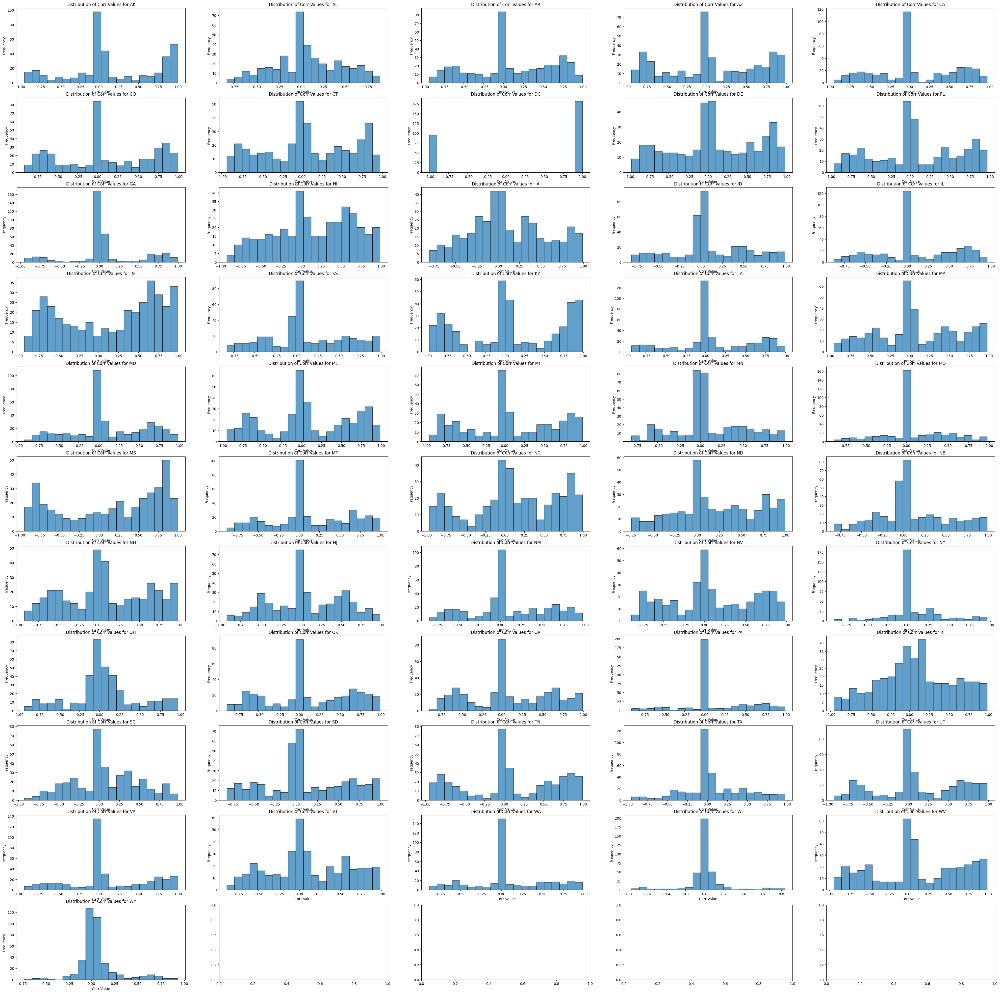

In [388]:
grouped = df2.groupby('state') # So group each by state
fig, axes = plt.subplots(nrows=11, ncols=5, figsize=(50, 50))  # Adjust figsize as needed

for i, (state, group) in enumerate(grouped):
    ax = axes[i // 5, i % 5]  # Calculate the correct subplot based on row and column ( a 10 by 5 basically with extra steps)
    ax.hist(group['Corr'], bins=20, edgecolor='k', alpha=0.7)
    ax.set_title(f'Distribution of Corr Values for {state}')
    ax.set_xlabel('Corr Value')
    ax.set_ylabel('Frequency')

# 11/08/2023 Now do all of the above with 2020 and 2021 and look at the cor values  and compare them year to year 

## Troubleshooting Zone ENDS

In [ ]:
print(result1[0])

# Parent code

In [ ]:

#sb=s2020['Measure'].unique() # Nope need to append them so they don't just blob into one

In [ ]:
# Appending all of them to a list and providing an index so they can be itertaed over

new_list_of_measures = []
for i in sb:
    if i not in new_list_of_measures:
        new_list_of_measures.append(i)
list_of_lists = [[index, string] for index, string in enumerate(new_list_of_measures)] # have to enumerate this


Going to use itertools combinations to get all possible combos of 2, no replacement. 

### Maybe put the math calculation for that here

In [ ]:
subsets = list(sorted((itertools.combinations(list_of_lists,2)))) # this seemed to work okay for itertools

The Below code calculates the spearmans R for all of the combinations of Measure Variables. 

In [ ]:
counter = 0
correlation = []


def running_states(state):
	print(state['StateAbbr'].unique())
	counter = 0
	for subset in subsets:
		for pair in subset:
			first_element = pair[1]  # Access the first element in the pair
			if pair is not subset[0]:
				continue
			second_element = subset[1][1]  # Access the second element in the pair
			# Run corr analysis where two lists from each state 
					#lis1 = (f"{NC}.loc['Measure']=={first_element}]")
		
			lis1 = state.loc[state['Measure']==first_element,'Data_Value']

			lis2 = state.loc[state['Measure']==second_element,'Data_Value']
			#print(f"Processing pair:{corr})")


				# You can perform your desired action on first_element and second_element here
				# For example, you can call the 'cor' function:
			counter +=1
	corr,_=spearmanr(lis1,lis2)
	print(f"Processing pair: First element {first_element}\n, Second element : {second_element}\n, Corr result = {corr},)")
	correlation.append([first_element,second_element,corr])
	print(len(lis1),len(lis2))


In [ ]:
for i in dataframes_list:
    running_states(i)

In [ ]:
df1 = pd.DataFrame(correlation)

In [ ]:
df1

# End Parent Code

# More Troubleshooting Code Below

Making all of the states appear in the list. As I worked on this I actually made a nice check. By printing the len of each list I can check manually to make sure my data is iterating correctly. Not the fastest method, but a good one for sure. 

# The code Below works and Works well,  


## Update code works now. And prints the values


In [ ]:
correlation =[]
a_ =[]
b_ =[]

def running_states(state):
	print(state['StateAbbr'].unique())
	counter = 0
	for subset in subsets:
		for pair in subset:
			first_element = pair[1]  # Access the first element in the pair
			if pair is not subset[0]:
				continue
			second_element = subset[1][1]  # Access the second element in the pair
			# Run corr analysis where two lists from each state 
					#lis1 = (f"{NC}.loc['Measure']=={first_element}]")
		
			lis1 = state.loc[state['Measure']==first_element,'Data_Value']

			lis2 = state.loc[state['Measure']==second_element,'Data_Value']
			#print(f"Processing pair:{corr})")


				# You can perform your desired action on first_element and second_element here
				# For example, you can call the 'cor' function:
			counter +=1
			a,b = first_element,second_element
			a_.append(a)
			b_.append(b)
	corr,_=spearmanr(lis1,lis2)
	print(f"Processing pair:{corr},{a_},{b_})")
	correlation.append([a_,b_,corr])
	print(len(lis1),len(lis2))

In [ ]:
running_states(NC)


In [ ]:
df1 = pd.DataFrame(correlation)

In [ ]:
df1

In [ ]:
lis1 = NC.loc[NC['Measure']=='Stroke_among_adults_aged_>=18_years','Data_Value']

In [ ]:
lis1["StateAbbr"]

Now I need to get the subsets and with those subsets for each state I need to do correlation analysis
Goint to try to use a for loop from R in python

In [ ]:
%load_ext rpy2.ipython

Got where the values are NC and will compare them to those tomorrow. 

In [ ]:
lmn=s2021.loc[(s2021['Measure'] =="Current asthma among adults aged >=18 years") & (s2021['StateAbbr'] =="NC")]

In [ ]:
#lmn =s2021[s2021['Measure']=="Current asthma among adults aged >=18 years"]

In [ ]:
lmn

I need to look over the appropriate dist. To see which one to use for the QQ plot

In [ ]:
df1= pd.read_csv('2020_data_df')

In [ ]:
abc = df1[df1['Measure_Name']=='Current_asthma_among_adults_aged_>=18_years'] # Selecting all of this specific measure name 

In [ ]:
abc

Okay so Already have ALL distribution work done. 

Now I need to run some tests. Which I will figure out. Maybe just compare year to year instead of an overall average?

In [ ]:
stats.shapiro(lmn['Data_Value'])